In [1]:
import sys
import os
import json

from math import atan2, pi

import matplotlib.pyplot as plt

cwd = os.path.abspath(os.path.join('..'))
cwd = 'd:\\WindowsFolders\\Code\\Master\\jayde16_olvea16_masters_2021\\robsim'

if cwd not in sys.path:
    sys.path.append(cwd)

print(f'cwd: {cwd}')

import robsim as rs

print(f'robsim module version: {rs.__version__}')

import numpy as np
import random

seed = 0

np.random.seed(seed)
random.seed(seed)

cwd: d:\WindowsFolders\Code\Master\jayde16_olvea16_masters_2021\robsim
robsim module version: 0.0.1a


In [2]:
config_file = os.path.join(cwd, 'workspaces/office_workspace_1.json')
map_file = os.path.join(cwd, 'workspaces/office_workspace_1.png')

ws = rs.Workspace(
    config_file=config_file, 
    background_file=map_file
)


In [3]:
i = rs.timed_input('Enter manual landmarks? (y/n): ', 'Timed out, using default landmarks.', timeout=5)

if i == 'y':
    ws.plot(figname='Workspace', grid_size=1)
    plt.show(block=False)

    print(f'Click to place landmarks.')

    landmarks = plt.ginput(n=-1)

    path = os.path.join(cwd, 'data/office_workspace_1_default_landmarks.json')
    with open(path, 'w') as f:
        json.dump(landmarks, f)

else:
    path = os.path.join(cwd, 'data/office_workspace_1_default_landmarks.json')
    with open(path, 'r') as f:
        landmarks = json.load(f)

default_landmarks = (i != 'y')

ws.set_landmarks(landmarks)

Enter manual landmarks? (y/n): Timed out, using default landmarks.


In [4]:
i = rs.timed_input('Enter manual path? (y/n): ', 'Timed out, using default path.', timeout=5)

if i == 'y':
    ws.plot(figname='Workspace', grid_size=1)
    plt.show(block=False)

    print(f'Click to make a path for the robot to follow.')

    nodes = plt.ginput(n=-1)

    path = os.path.join(cwd, 'data/office_workspace_1_default_route.json')
    with open(path, 'w') as f:
        json.dump(nodes, f)

else:
    path = os.path.join(cwd, 'data/office_workspace_1_default_route.json')
    with open(path, 'r') as f:
        nodes = json.load(f)

default_route = (i != 'y')


Enter manual path? (y/n): Timed out, using default path.


In [5]:
d = 0.01 # Approximate step size for the interpolation.

angles = [atan2((y2 - y1), (x2 - x1)) for (x1, y1), (x2, y2) in zip(nodes[:-1], nodes[1:])]
angles = [angles[0]] + angles

angles = [angle % (2 * pi) for angle in angles]

for i in range(len(angles) - 1):
    angles[i + 1] = rs.minimize_angular_difference(angles[i], angles[i + 1])

poses = [rs.Pose(click[0], click[1], v) for v, click in zip(angles, nodes)]

poses = [poses[0]] + poses + [poses[-1]]

paths = [rs.rom_spline(poses[i:i+4], d=d) for i in range(len(poses) - 3)]

full_route = [pose for path in paths for pose in path]

# This breaks noise application
#route = [rs.Pose(pose.x, pose.y, pose.theta % (2 * pi)) for pose in route]


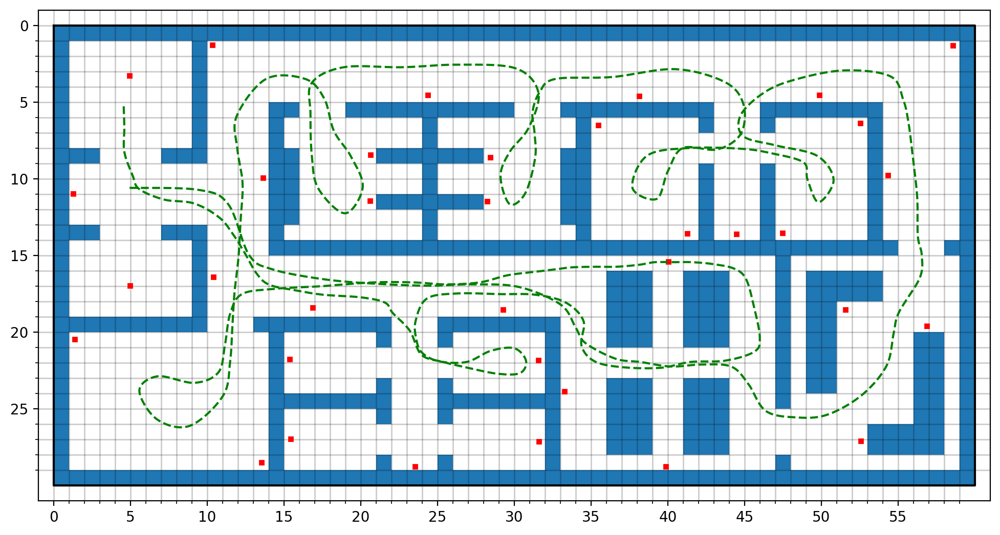

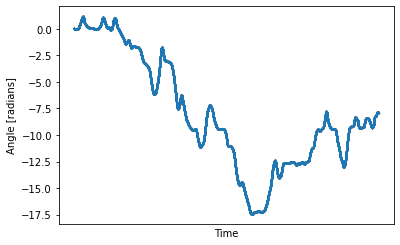

In [6]:
if rs.check_ipython():
    ws.plot(figname='Workspace', grid_size=1)

    route_x = [pose.x for pose in full_route]
    route_y = [pose.y for pose in full_route]

    plt.plot(route_x, route_y, '--', color='green')

    plt.figure('Angle')

    ax = plt.gca()
    ax.set_ylabel('Angle [radians]')
    ax.set_xlabel('Time')
    ax.set_xticks([])

    plt.plot([pose.theta for pose in full_route], '.', markersize=1)

    plt.show(block=False)


In [7]:
route = rs.reduce_list(full_route, 0.01)

default_route = False

print(f'Reduced route from {len(full_route)} nodes to {len(route)} nodes.')


Reduced route from 35761 nodes to 358 nodes.


In [8]:
from tqdm import tqdm

print(f'Default landmarks - {default_landmarks} and default route - {default_route}: ', end='')

default_measurements = (default_landmarks and default_route)

if not default_measurements:
    print('Computing measurements.')
    landmarks = []
    for pose in tqdm(route):
        measurements = []
        for i, landmark in enumerate(ws.landmarks):
            origin = rs.Point(pose.x, pose.y)
            landmark = rs.Point(*landmark)
            line = rs.Line(origin, landmark)

            intersections = ws.get_intersections(line)
            intersections = [rs.Point(*i) for i in intersections]
            
            d = rs.dist_l2(origin, landmark)

            if not any([False] + [d > rs.dist_l2(origin, i) for i in intersections]):
                pt = landmark.relative(pose)
                measurements.append((i, pt))
        landmarks.append(measurements)
else:
    print('Using pre-computed measurements.')
    path = os.path.join(cwd, 'data/office_workspace_1_default_landmark_measurements.json')
    with open(path, 'r') as f:
        landmarks = json.load(f)
    
    landmarks = [[(pt[0], rs.Point(*pt[1:])) for pt in measurements] for measurements in landmarks]
    

100%|██████████| 358/358 [00:03<00:00, 100.76it/s]


In [9]:
path = os.path.join(cwd, 'data/office_workspace_1_default_landmark_measurements.json')
with open(path, 'w') as f:
    json.dump([[[i, pt.x, pt.y] for i, pt in measurements] for measurements in landmarks], f)


In [10]:
if not default_route:
    lidar_scans = [ws.lidar_scan(pose, fov=360, da=1.25) for pose in tqdm(route)]
    lidar_scans = [[pt.relative(pose) for pt in scan] for pose, scan in zip(route, lidar_scans)]
 
    path = os.path.join(cwd, 'data/office_workspace_1_default_lidar_scans.json')
    with open(path, 'w') as f:
        obj = [[[pt.x, pt.y] for pt in scan] for scan in lidar_scans]
        json.dump(obj, f)

else: 
    path = os.path.join(cwd, 'data/office_workspace_1_default_lidar_scans.json')
    with open(path, 'r') as f:
        lidar_scans = json.load(f)
        lidar_scans = [[rs.Point(*pt) for pt in scan] for scan in lidar_scans]
        

100%|██████████| 358/358 [00:24<00:00, 14.39it/s]


In [ ]:
from robsim.utility import add_radial_noise_pose as noise

odometry_std_d = 0.08
odometry_std_a1 = 0.035
odometry_std_a2 = 0.035

print(f'Adding odometry noise with standard deviations:\ndistance - {odometry_std_d}\nangle 1 - {odometry_std_a1}\nangle 2 - {odometry_std_a2}')

relative_route = [b.relative(a) for a, b in zip(route[:-1], route[1:])]
noisy_relative_route = [noise(pose, std_d=odometry_std_d, std_a1=odometry_std_a1, std_a2=odometry_std_a2) for pose in relative_route]
noisy_route = [route[0]]
for pose in noisy_relative_route: noisy_route.append(pose.absolute(noisy_route[-1]))

fig = ws.plot(figname='Workspace', figsize=(8, 8))
plt.title('Odometry noise')
plt.plot([p.x for p in route], [p.y for p in route], '--', color='green', label='true route')
plt.plot([p.x for p in noisy_route], [p.y for p in noisy_route], '-', color='red', label='noisy route')
plt.legend()
plt.show()


100%|██████████| 358/358 [00:00<00:00, 28697.91it/s]Adding landmark noise with standard deviations:
distance - 0.01
angle - 0.005

100%|██████████| 35/35 [00:00<00:00, 701.86it/s]Plotting points...



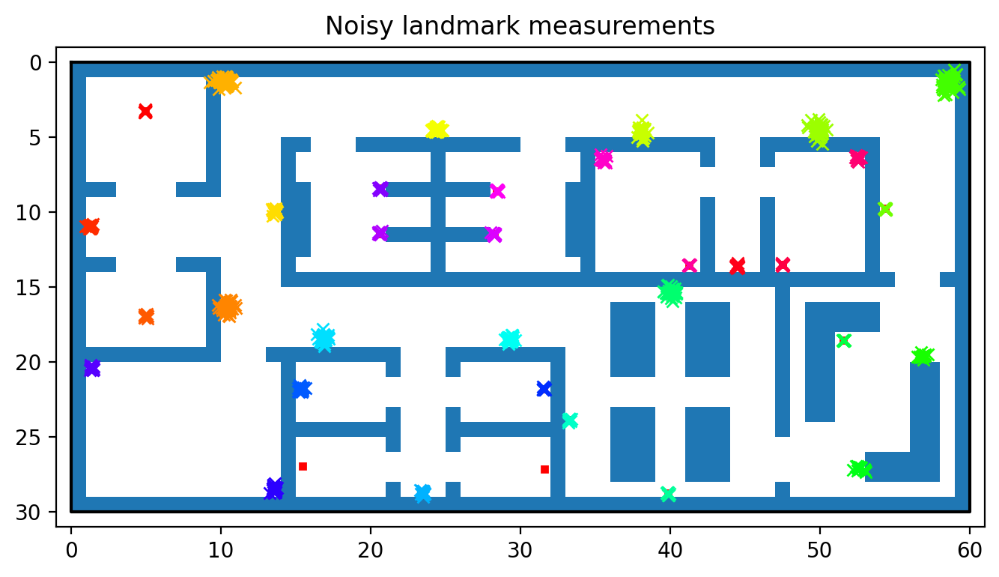

In [12]:
from robsim.utility import add_radial_noise_point as noise
landmark_std_d = 0.01
landmark_std_a = 0.005

print(f'Adding landmark noise with standard deviations:\ndistance - {landmark_std_d}\nangle - {landmark_std_a}')

noisy_landmarks = [[[i, noise(point, std_d=landmark_std_d, std_a=landmark_std_a)] for i, point in measurements] for measurements in tqdm(landmarks)]

cmap = plt.cm.get_cmap('hsv', len(ws.landmarks))

fig = ws.plot(figname='Workspace', figsize=(8, 8))
plt.title('Noisy landmark measurements')

print('Plotting points...')
for i in tqdm(range(len(ws.landmarks))):
    pts = []
    for j, measurements in enumerate(noisy_landmarks):
        for k, point in measurements:
            if i == k:
                pts.append(point.absolute(route[j]))

    plt.plot([pt.x for pt in pts], [pt.y for pt in pts], 'x', color=cmap(i))
plt.show()


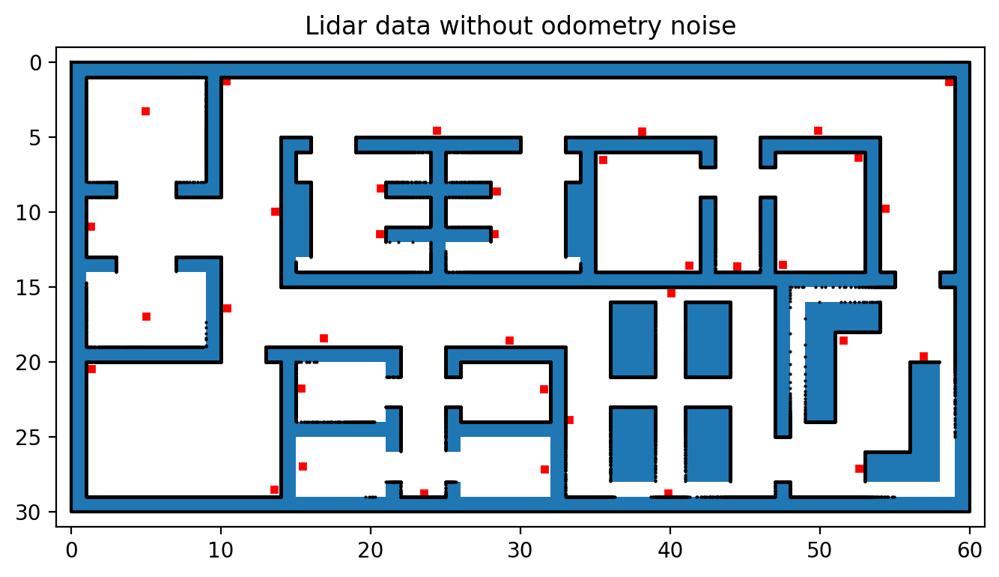

In [13]:
lidar_absolute = [[pt.absolute(pose) for pt in scan] for pose, scan in zip(route, lidar_scans)]

ws.plot(figsize=(8, 8), dpi=200)
plt.title('Lidar data without odometry noise')
x = [pt.x for scan in lidar_absolute for pt in scan]
y = [pt.y for scan in lidar_absolute for pt in scan]
plt.plot(x, y, '.', color='black', markersize=1)
plt.show()


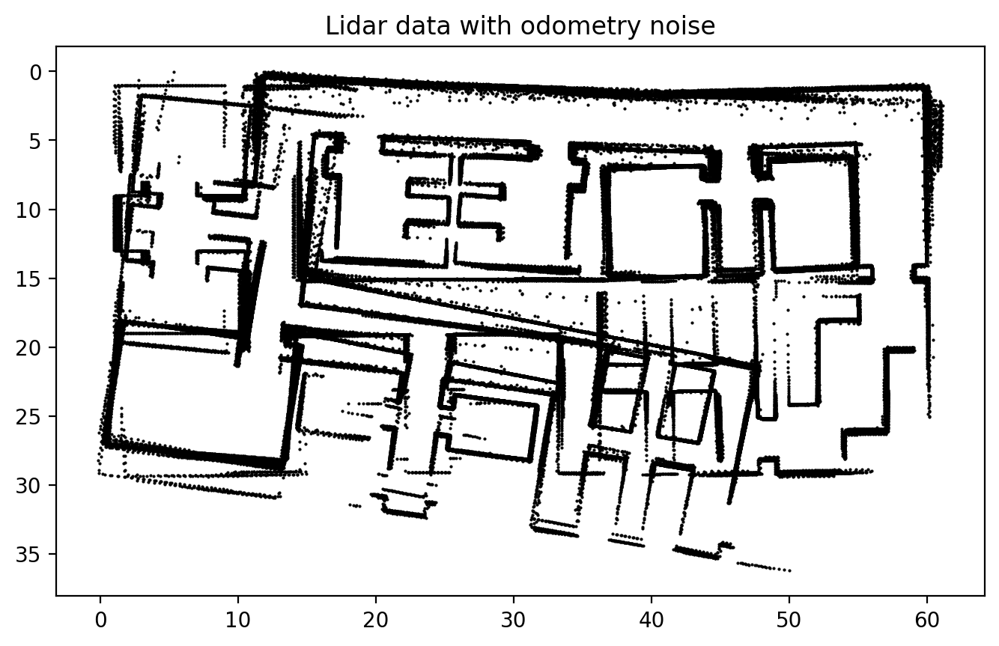

In [14]:
noisy_lidar_absolute = [[pt.absolute(pose) for pt in scan] for pose, scan in zip(noisy_route, lidar_scans)]

plt.figure(figsize=(8, 8), dpi=200)
plt.title('Lidar data with odometry noise')
x = [pt.x for scan in noisy_lidar_absolute for pt in scan]
y = [pt.y for scan in noisy_lidar_absolute for pt in scan]
plt.plot(x, y, '.', color='black', markersize=1)
ax = plt.gca()
ax.invert_yaxis()
ax.set_aspect(1)
plt.plot()
plt.show()

In [15]:
print(f'{len(route)}, {len(noisy_route)}, {len(relative_route)}, {len(noisy_relative_route)}')


358, 358, 357, 357


Doing slam with options: (animate)
Loss function - soft_l1
Using sparsity matrix - True
Trust-region Solver - lsmr
gtol - 1e-06
xtol - 1e-06
ftol - 1e-06
100%|██████████| 357/357 [24:19<00:00,  4.08s/it]

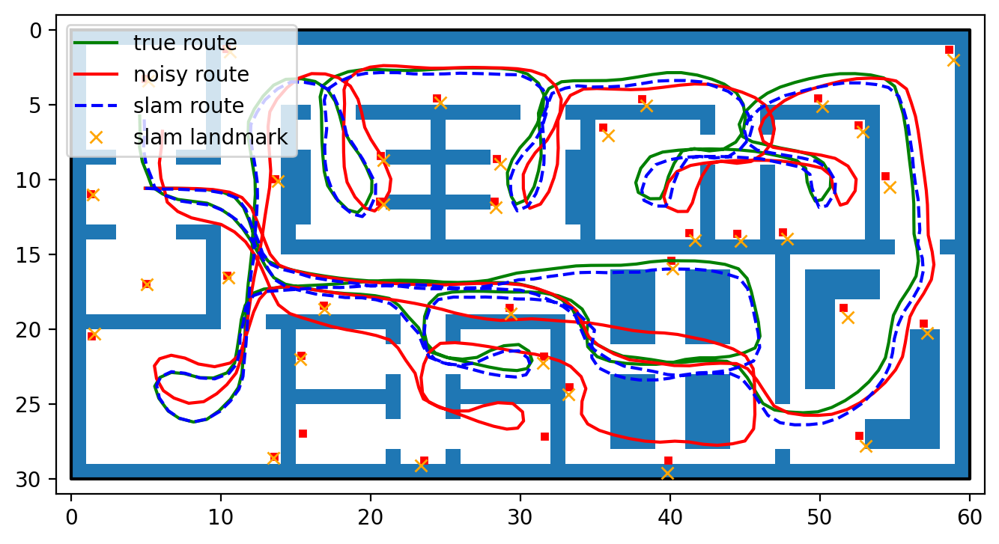

In [16]:
loss = 'soft_l1'
sparsity = True
tr_solver = 'lsmr'

ftol = xtol = gtol = 1e-6

use_tqdm = True

plot = 'animate'

n_slam_steps = len(noisy_relative_route)
#n_slam_steps = 80

to_print = [
    f'Doing slam with options: ({plot})',
    f'Loss function - {loss}',
    f'Using sparsity matrix - {sparsity}',
    f'Trust-region Solver - {tr_solver}',
    f'gtol - {gtol}',
    f'xtol - {xtol}',
    f'ftol - {ftol}',
    #f'',
]

print('\n'.join(to_print))

slam = rs.Slam(route[0], n_landmarks=len(ws.landmarks), var_odometry_d=odometry_std_d, var_odometry_theta1=odometry_std_a1, var_odometry_theta2=odometry_std_a2, var_landmarks_d=landmark_std_d, var_landmarks_theta=landmark_std_a)

fig = ws.plot(figsize=(8, 8), dpi=200)

lr = plt.plot(route[0].x, route[0].y, '-', color='green', label='true route')[0]
lnr = plt.plot(noisy_route[0].x, noisy_route[0].y, '-', color='red', label='noisy route')[0]
lsr = plt.plot(slam.route[0].x, slam.route[0].y, '--', color='blue', label='slam route')[0]
pl = plt.plot([0], [0], 'x', color='orange', label='slam landmark')[0]

plt.legend()

path = os.path.join(cwd, 'images/')

if use_tqdm:
    pbar = tqdm(total=n_slam_steps)

else:
    class Null:
        def update():
            pass

    pbar = Null

def update():
    lr.set_data([pt.x for pt in route[:len(slam.route)]], 
                [pt.y for pt in route[:len(slam.route)]])

    lnr.set_data([pt.x for pt in noisy_route[:len(slam.route)]], 
                [pt.y for pt in noisy_route[:len(slam.route)]])

    lsr.set_data([pt.x for pt in slam.route], 
                [pt.y for pt in slam.route])

    pl.set_data([p.x for p, initialized in zip(slam.landmarks, slam.landmark_initialized) if initialized],
                [p.y for p, initialized in zip(slam.landmarks, slam.landmark_initialized) if initialized])

    return lr, lnr, lsr, pl

for i in range(n_slam_steps):   
    pbar.update()

    odometry_constraint, landmark_constraints = noisy_relative_route[i], noisy_landmarks[i + 1]    

    slam.add_constraints(odometry_constraint, landmark_constraints)
    slam.optimize(use_sparsity=sparsity, loss=loss, tr_solver=tr_solver, ftol=ftol, gtol=gtol, xtol=xtol)

    if plot == 'animate':
        update()
        plt.draw()
        path = os.path.join(cwd, 'images/', f'{i:04d}.png')
        plt.savefig(path)

if plot == 'final_still':
    update()
    plt.show()


route: 358
landmarks: 35
m = 1589, n = 1144
Sparsity matrix shape: (1589, 1144)


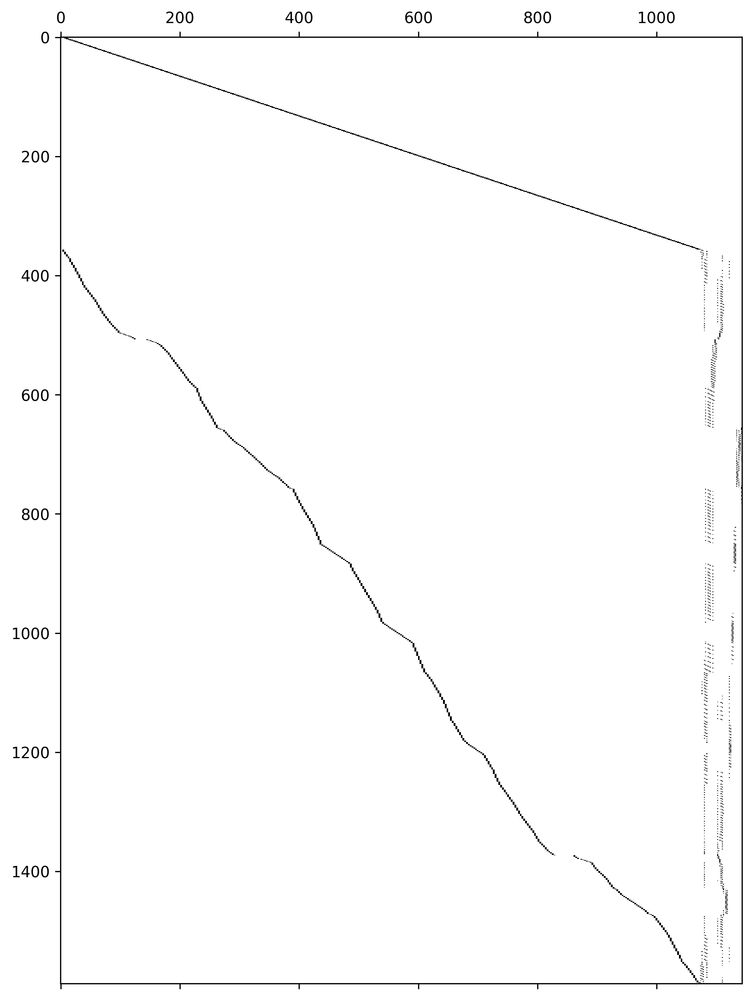

In [17]:
sparsity = slam.get_sparsity()

print(f'route: {len(slam.route)}')
print(f'landmarks: {len(slam.landmarks)}')

n = len(slam.route)*3+len(slam.landmarks)*2
m = len(slam.odometry_constraints) + sum(len(constraints) for constraints in slam.landmark_constraints)

print(f'm = {m}, n = {n}')
print(f'Sparsity matrix shape: {sparsity.shape}')

fig = plt.figure(figsize=(8,12), dpi=300)
plt.spy(sparsity)


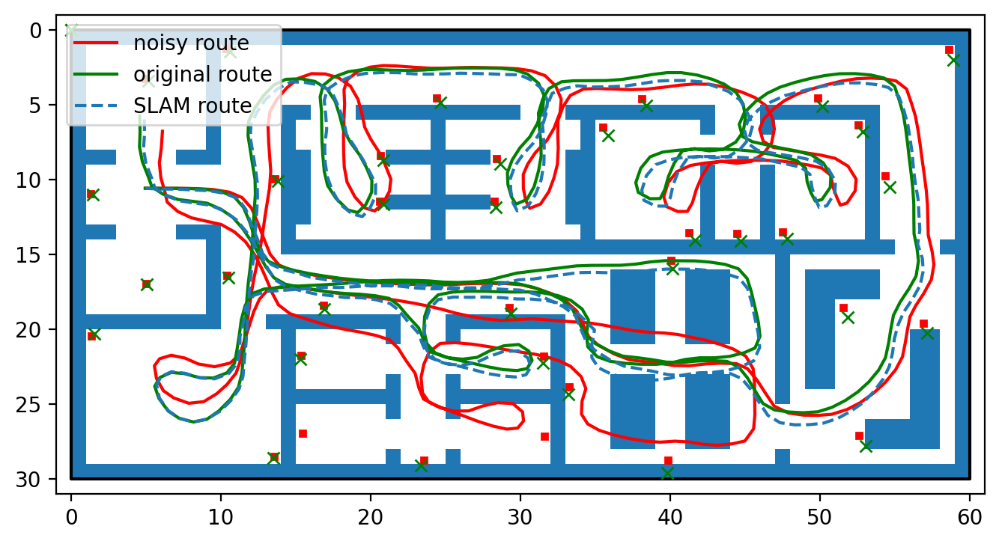

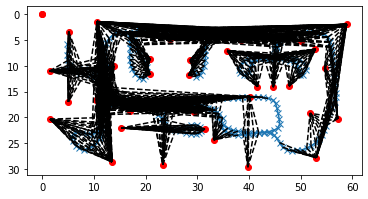

In [18]:
ws.plot(figsize=(8, 8), dpi=200)

x = [pt.x for pt in noisy_route]
y = [pt.y for pt in noisy_route]
plt.plot(x, y, '-', color='red', label='noisy route')

x = [pt.x for pt in route]
y = [pt.y for pt in route]
plt.plot(x, y, '-', color='green', label='original route')

x = [pt.x for pt in slam.route]
y = [pt.y for pt in slam.route]
plt.plot(x, y, '--', label='SLAM route')

x = [pt.x for pt in slam.landmarks if pt != None]
y = [pt.y for pt in slam.landmarks if pt != None]
plt.plot(x, y, 'x', color='green')

plt.legend()
plt.show(block=False)

fig = slam.plot(plot_landmark_measurements=True)
ax = plt.gca()
ax.invert_yaxis()
plt.show()

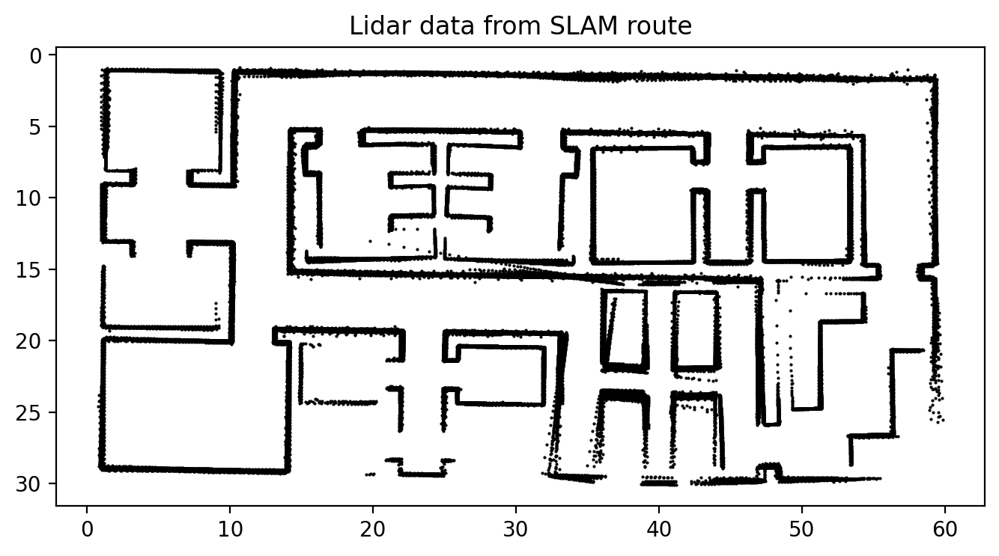

In [19]:
slam_lidar_absolute = [[pt.absolute(pose) for pt in scan] for pose, scan in zip(slam.route, lidar_scans)]

plt.figure(figsize=(8, 8), dpi=200)
plt.title('Lidar data from SLAM route')
x = [pt.x for scan in slam_lidar_absolute for pt in scan]
y = [pt.y for scan in slam_lidar_absolute for pt in scan]
plt.plot(x, y, '.', color='black', markersize=1)
ax = plt.gca()
ax.invert_yaxis()
ax.set_aspect(1)
plt.plot()
plt.show()

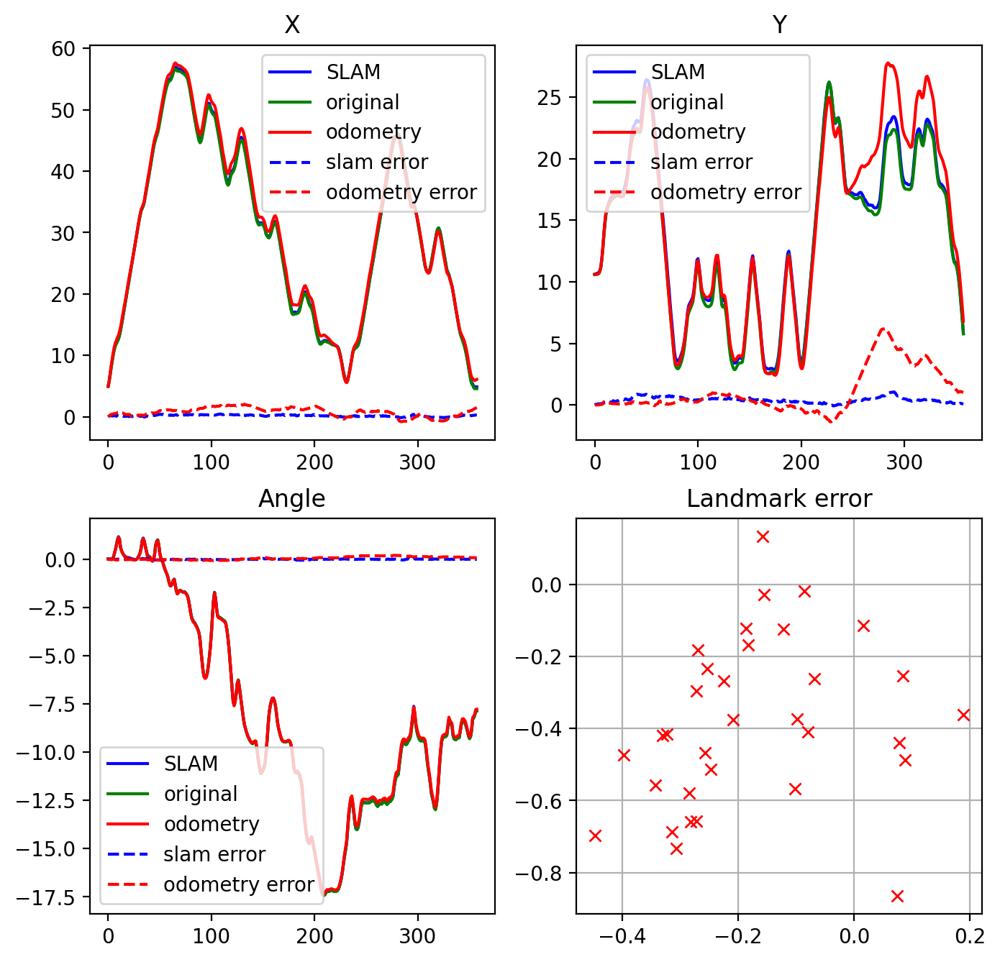

In [21]:

figs, axs = plt.subplots(2, 2, figsize=(8,8), dpi=200)

axs[0,0].set_title('X')
axs[0,0].plot([pose.x for pose in slam.route], '-', color='blue', label='SLAM')
axs[0,0].plot([pose.x for pose in route], '-', color='green', label='original')
axs[0,0].plot([pose.x for pose in noisy_route], '-', color='red', label='odometry')
axs[0,0].plot([b.x - a.x for a, b in zip(route, slam.route)], '--', color='blue', label='slam error')
axs[0,0].plot([b.x - a.x for a, b in zip(route, noisy_route)], '--', color='red', label='odometry error')
axs[0,0].legend()

axs[0,1].set_title('Y')
axs[0,1].plot([pose.y for pose in slam.route], '-', color='blue', label='SLAM')
axs[0,1].plot([pose.y for pose in route], '-', color='green', label='original')
axs[0,1].plot([pose.y for pose in noisy_route], '-', color='red', label='odometry')
axs[0,1].plot([b.y - a.y for a, b in zip(route, slam.route)], '--', color='blue', label='slam error')
axs[0,1].plot([b.y - a.y for a, b in zip(route, noisy_route)], '--', color='red', label='odometry error')
axs[0,1].legend()

axs[1,0].set_title('Angle')
axs[1,0].plot([pose.theta for pose in slam.route], '-', color='blue', label='SLAM')
axs[1,0].plot([pose.theta for pose in route], '-', color='green', label='original')
axs[1,0].plot([pose.theta for pose in noisy_route], '-', color='red', label='odometry')
axs[1,0].plot([b.theta - a.theta for a, b in zip(route, slam.route)], '--', color='blue', label='slam error')
axs[1,0].plot([b.theta - a.theta for a, b in zip(route, noisy_route)], '--', color='red', label='odometry error')
axs[1,0].legend()

landmark_locations = [rs.Point(*pt) for pt in ws.landmarks]

error_landmarks = [b - a for a, b, i in zip(slam.landmarks, landmark_locations, slam.landmark_initialized) if i]

axs[1,1].set_title('Landmark error')
axs[1,1].plot([pt.x for pt in error_landmarks], [pt.y for pt in error_landmarks], 'x', color='red')
axs[1,1].grid(True)

plt.show()
